# Lesson 5 - Miscallenous Topics: Command Line, Pathing, and GitHub

In order to use this file, please do the following:
*   Go to the top left corner of Google Colab and click  `File -> Save a copy in Drive`

Here's a rough overview of our plan for the weekly curriculum:

* Week 2: Introduction to Python and OOP
* Week 3: How to Code Like a Pro
* Week 4: Data Preparation and Cleaning
* Week 5: Data Visualization and Exploratory Data Analysis
* **Week 6: Miscallenous Topics - Command Line, Pathing, and GitHub**
* Week 7: Introduction to Machine Learning
* Week 8: Advanced Topics in Machine Learning
* Week 9: How to Succeed Going Forward

#Outline

1. Pathing
  * What are directories?
  * How does Python deal with them?
    * The `os` package
  * Practical example: loading and reshaping a complex dataset
    * `json` 😈
    * `cv2` 😈

2. GitHub
  * What is version control? Why is it useful?
  * Getting set up with GitHub
  * Creating and managing your first repository



---
# 1. Pathing
* "There's a reason every pwd has a W in it" - *Daniel*
* "Use ur command line fs" - *Nick*
* "I love GitHub" - *Vince Front, Membership Director of DSU*

Last lesson, we walked you through the fundamentals of data exploration and visualization. But today, we're going to take a slight detour from data and focus on some important fundamental skills. This lesson covers important practical topics in programming unrelated to writing code -- these include understanding how Python handles directories (and working with datasets in nested directories) and introducing version control with GitHub.

These are more miscellaneous topics that are very useful for programming *in general*, not just for data science. But understanding how to deal with pathing and unclean data storage is crucial for many industry-related data science tasks. 

## What are directories? 
### (And how do operating systems (OS) store information?)

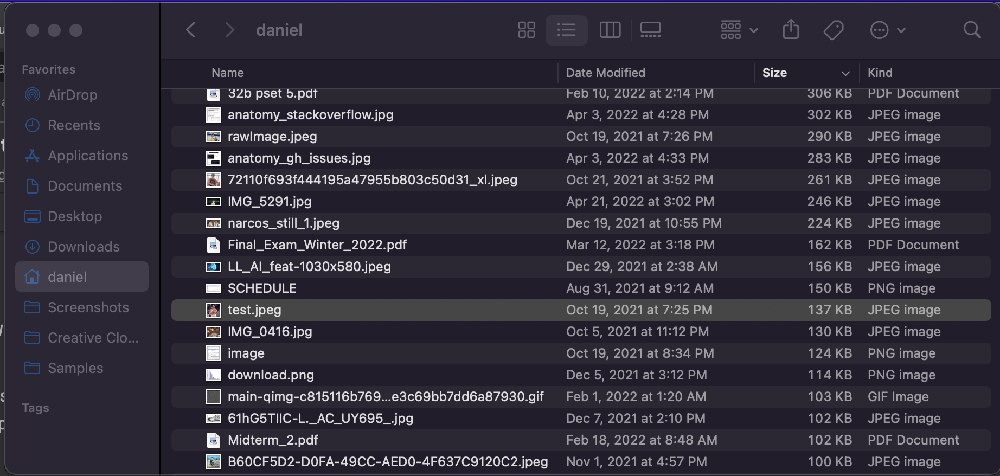

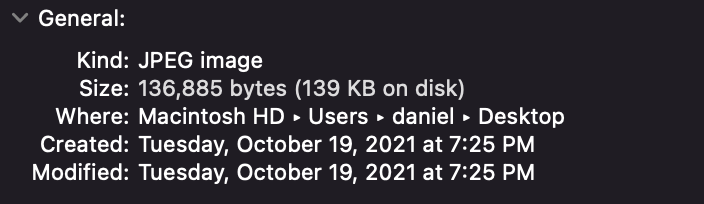

Above is an example of a file stored on my computer (excuse the messy Desktop). On a mac, you can right click on a file and click "Get Info" to see the location of the image on your computer. As you can see, my file "test.jpeg" has a super specific location on my computer. The names of the folders which specify my location are called "directories."

The first thing I want to draw your attention to is this heirarchical structure of directories. The base directory is Macintosh HD, and each subsequent directory is a folder inside the previous directory we've seen. That is to say, "Users" lies in the Macintosh HD directory, "daniel" lies inside the Users directory, etc.

Every file on your computer lives in a directory. This includes the Python files you run! Take note of this.

## How does Python interact with directories? 

In [ ]:
import os
import numpy as np
os.getcwd()

'/content'

Python uses a built in library called `os` to deal with anything related to your operating system. When working with files (like datasets), `os` comes in super handy. Above, we ran the `getcwd()` command which returns a string of the **C**urrent **W**orking **D**irectory (CWD). This tells us *where* our Python file resides, aka its address, aka its directory.

In [ ]:
os.listdir()

['.config', 'sample_data']

OS lets us also take a look at all the files *inside* of our directory with the `listdir()` function (this includes potential subfolders). 

In [ ]:
os.listdir('sample_data')

['anscombe.json',
 'README.md',
 'california_housing_test.csv',
 'california_housing_train.csv',
 'mnist_train_small.csv',
 'mnist_test.csv']

`os.listdir()` actually takes a directory as an argument, called a "path" (short for filepath). However, if you pass nothing, it defaults to your current directory. 

Notice how `sample_data` is a folder in our previous directory since it has no file extension. If we just pass the folder name as a directory, Python knows to look inside that folder.

## 🚨🚨🚨🚨🚨 Relative vs. Absolute Paths 🚨🚨🚨🚨🚨

In [ ]:
os.listdir('/content/sample_data')

['anscombe.json',
 'README.md',
 'california_housing_test.csv',
 'california_housing_train.csv',
 'mnist_train_small.csv',
 'mnist_test.csv']

## Sidenote / warning: mac (and linux?) users use forward slash ( / ) to differentiate directories, but windows users use backslash ( \\ ) to separate directories. If you're a windows user, I'm terribly sorry

When we want to access files nested in multiple directories, we use *slashes* to differentiate each directory. 

But why did both this example and the example work? Even though we're referencing the same directory, we passed in two different strings. How did Python know that we're referring to the same location?

## Relative paths are paths *relative* to your current directory, and absolute paths are paths *relative* to the root directory

In the above case, `/content/sample_data` is an absolute path, since `/content` is the root directory. 

## Quesetion: was the directory `Macintosh HD/Users/daniel/Desktop/test.jpeg` from the first example an **absolute** or **relative** path? (The file information was viewed in the Desktop folder)

In [ ]:
import pandas as pd

df = pd.read_csv('sample_data/california_housing_test.csv')
df2 = pd.read_csv('/content/sample_data/california_housing_test.csv')

df.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
0,-122.05,37.37,27.0,3885.0,661.0,1537.0,606.0,6.6085,344700.0
1,-118.30,34.26,43.0,1510.0,310.0,809.0,277.0,3.5990,176500.0
2,-117.81,33.78,27.0,3589.0,507.0,1484.0,495.0,5.7934,270500.0
3,-118.36,33.82,28.0,67.0,15.0,49.0,11.0,6.1359,330000.0
4,-119.67,36.33,19.0,1241.0,244.0,850.0,237.0,2.9375,81700.0


In [ ]:
df2.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
0,-122.05,37.37,27.0,3885.0,661.0,1537.0,606.0,6.6085,344700.0
1,-118.30,34.26,43.0,1510.0,310.0,809.0,277.0,3.5990,176500.0
2,-117.81,33.78,27.0,3589.0,507.0,1484.0,495.0,5.7934,270500.0
3,-118.36,33.82,28.0,67.0,15.0,49.0,11.0,6.1359,330000.0
4,-119.67,36.33,19.0,1241.0,244.0,850.0,237.0,2.9375,81700.0


A lot of Python code works with both relative and absolute paths (as seen above, pandas is able to load csvs from both local and relative paths). But unless you need to access files outside your current directory, it's almost always easier to use relative paths. For a lot of data science problems, it's a good practice to make a folder with your Python code and data *in the same* directory to make pathing as simple as possible.

In [ ]:
data_dfs = {}
for fname in os.listdir('sample_data'):
  if fname.split('.')[-1] == 'csv':
    data_dfs[fname] = pd.read_csv('sample_data/' + fname)

data_dfs.keys()

dict_keys(['california_housing_test.csv', 'california_housing_train.csv', 'mnist_train_small.csv', 'mnist_test.csv'])

This for loop loads all the `csv` files in our directory as DataFrames and stores them in a dictionary with their file names. Note how when we call `pd.read_csv()`, we call it on `'sample_data/' + fname`, not just `fname`.

In [ ]:
for fname in os.listdir('sample_data'):
  print(fname)

anscombe.json
README.md
california_housing_test.csv
california_housing_train.csv
mnist_train_small.csv
mnist_test.csv


## If we tried loading these as csv's, we'd run into an error. Can anyone tell me why?

## Practical example: working with a messy dataset

This [kaggle dataset](https://www.kaggle.com/datasets/sharmaharsh/form-understanding-noisy-scanned-documentsfunsd) has tons of noisy scanned documents, and hand-labeled annotations telling you what each document says.

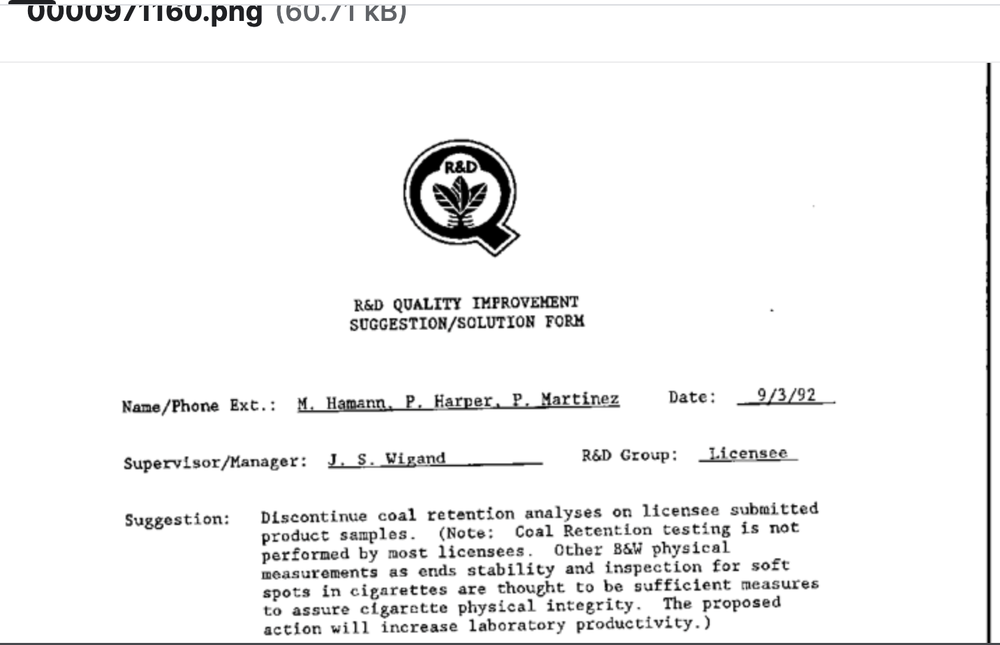

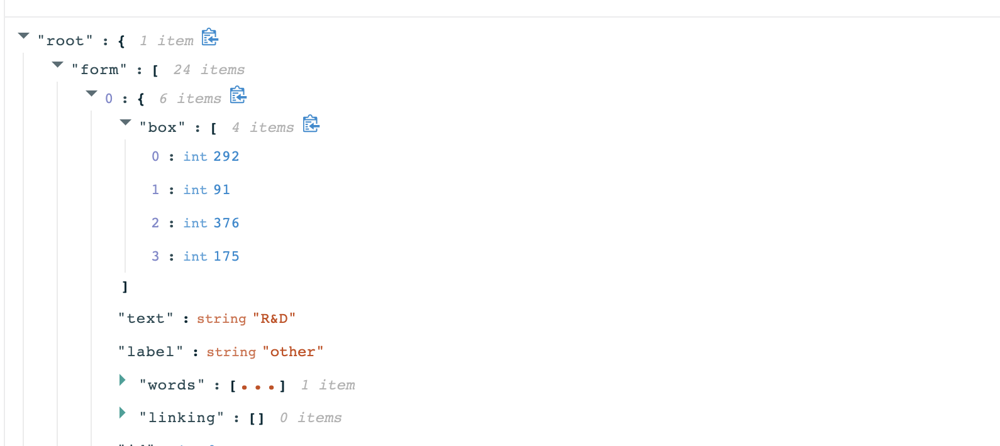

In order to download this dataset to your Google Colab, run the following command:

In [ ]:
!wget https://raw.githubusercontent.com/danielmend/dsu-data/main/data.zip

--2022-05-05 01:15:31--  https://raw.githubusercontent.com/danielmend/dsu-data/main/data.zip
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.111.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 16685527 (16M) [application/zip]
Saving to: ‘data.zip’

data.zip            100%[===================>]  15.91M  --.-KB/s    in 0.07s   

2022-05-05 01:15:31 (238 MB/s) - ‘data.zip’ saved [16685527/16685527]



In [ ]:
os.listdir()

['.config', 'data.zip', 'sample_data']

Notice how we now have 'data.zip' in our local directory. In most coding scenarios outside of colab, this is equivalent to downloading data online and putting it in the same folder as your code.

However, our dataset is currently a .zip, and we want to view it as a set of directories. To do this, we call `!unzip` (this is equivalent to double clicking a file on your computer to unzip)

In [ ]:
!unzip data.zip -d /content/

Archive:  data.zip
  inflating: /content/dataset/testing_data/annotations/82092117.json  
  inflating: /content/dataset/testing_data/annotations/82200067_0069.json  
  inflating: /content/dataset/testing_data/annotations/82250337_0338.json  
  inflating: /content/dataset/testing_data/annotations/82251504.json  
  inflating: /content/dataset/testing_data/annotations/82252956_2958.json  
  inflating: /content/dataset/testing_data/annotations/82253058_3059.json  
  inflating: /content/dataset/testing_data/annotations/82253245_3247.json  
  inflating: /content/dataset/testing_data/annotations/82253362_3364.json  
  inflating: /content/dataset/testing_data/annotations/82254765.json  
  inflating: /content/dataset/testing_data/annotations/82491256.json  
  inflating: /content/dataset/testing_data/annotations/82504862.json  
  inflating: /content/dataset/testing_data/annotations/82562350.json  
  inflating: /content/dataset/testing_data/annotations/82573104.json  
  inflating: /content/datase

In [ ]:
os.listdir()

['.config', 'dataset', 'data.zip', 'sample_data']

Now we have a folder called 'dataset' which has all of our data. Let's take a look inside and see what our data looks like.

In [ ]:
os.listdir('dataset')

['training_data', 'testing_data']

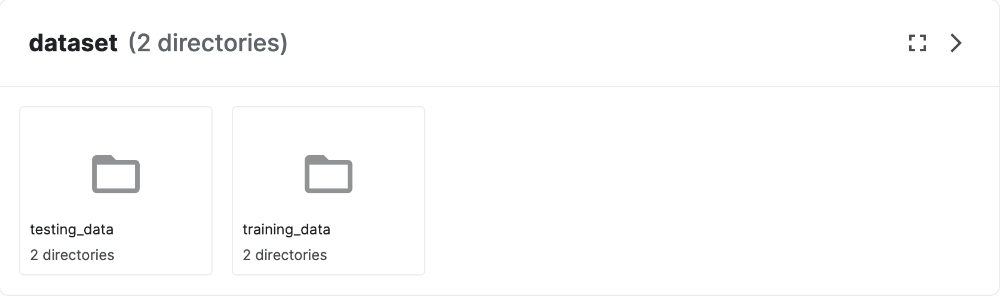

The output of listdir confirms information we could have seen on kaggle: our data is sorted into two directories, training and testing (more on this in future lessons). For the sake of the example, let's delve into the training_data directory.

In [ ]:
os.listdir('dataset/training_data')

['annotations', 'images']

As we can see, our data is split into two sections: raw image files and annotations. Let's see how our images and annotations are actually stored as files.

In [ ]:
os.listdir('dataset/training_data/images')[0:10]

['88057519.png',
 '0001485288.png',
 '92094751.png',
 '91361993.png',
 '92298125.png',
 '0011974919.png',
 '0000989556.png',
 '0001476912.png',
 '01197604.png',
 '92314414.png']

In [ ]:
os.listdir('dataset/training_data/annotations')[0:10]

['81749056_9057.json',
 '0060207528.json',
 '92586242.json',
 '91974562.json',
 '0000999294.json',
 '0001476912.json',
 '00860012_00860014.json',
 '01197604.json',
 '0011856542.json',
 '0012178355.json']

I've ommitted most of the outputs of `listdir()` to reduce clutter. But as you can see, our images are stored as pngs, and our outputs are stored as `json` files.

Json is a file format meant to help store information. You can think of a json file essentially as a dictionary. Under the hood, they're stored as strings, but the type of data they store is structured like a Python dictionary. The cool thing about json is that most programming langauges can interact with it, so if you store some data from a Python script in json, a server running javascript can open that data and interact with it. 

In order to read json data, we use the `json` package.

In [ ]:
import json

test_json_file = os.listdir('dataset/training_data/annotations')[0]
print(f'Opening: {test_json_file}')

with open('dataset/training_data/annotations/' + test_json_file, 'r') as f:
  j = json.load(f)

Opening: 81749056_9057.json


There's a few things going on here:
1. We find a single json filepath to open
2. We use `with open(fpath, 'r') as f` to tell Python: "open this file and store its data as a variable called `f`"
3. Finally, we pass this variable `f` to the json.load() method, and assign the json data to a variable `j`

In [ ]:
type(j)

dict

And as you can see, our annotations are stored as a dictionary now! Let's take a look at the contents of this dictionary

In [ ]:
j # all the data is stored in the "form" key of the dictionary

In [ ]:
j['form'][0]

{'box': [58, 123, 82, 134],
 'id': 0,
 'label': 'question',
 'linking': [[0, 43]],
 'text': 'TO:',
 'words': [{'box': [58, 123, 82, 134], 'text': 'TO:'}]}

Above is an example of a single annotation. Our annotation file has a list of these for a given image, and each annotation itself has a 'box' key, telling us the x_left, y_top, x_right, y_bottom values for the edges bounding box around a small piece of text, and the corresponding text within that box (stored in the 'text' key)

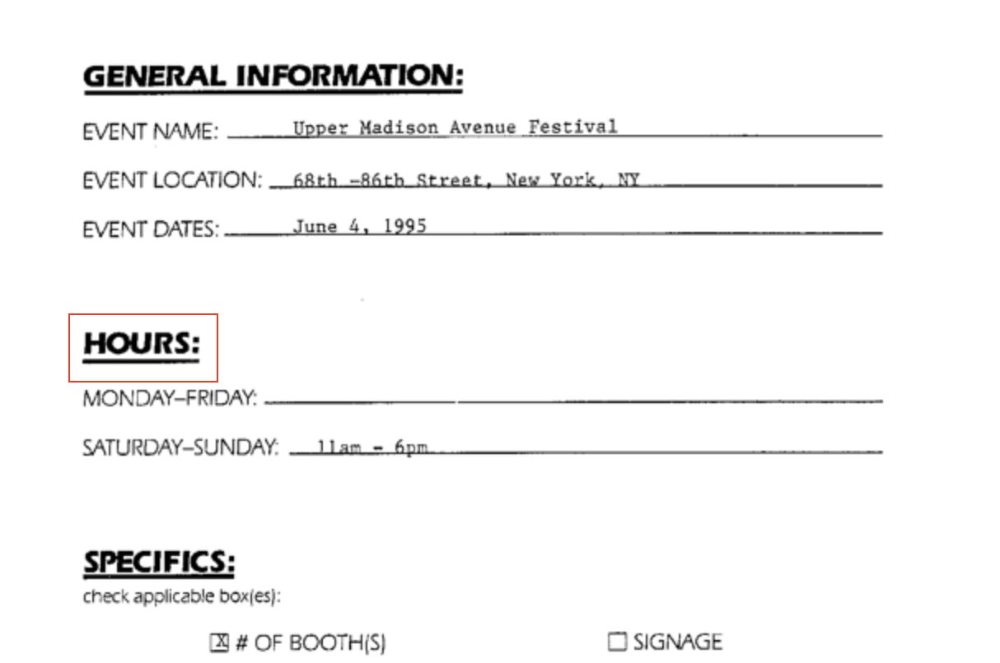

Now this begs the question, how does Python work with images? To understand this, we employ the `opencv` library, which is designed to help python coders deal with image data.

In [ ]:
import cv2
image_path = 'dataset/training_data/images/92586242.png'
im = cv2.imread(image_path)

cv2 has an `imread()` which takes in a filepath and reads the image for you. 

## Can anyone guess the datatype of the `im` variable?

In [ ]:
type(im)

numpy.ndarray

As it turns out, images are saved as numpy arrays! If you think about it, it makes sense. An image is basically a rectangle full of pixels, so how computers represent our image is by storing some pixel information in a grid-like fashion, like a pandas DataFrame. Let's take a look at the shape of this image.

In [ ]:
im.shape

(1000, 754, 3)

But wait... our array has 3 axes here, not 1 or 2 like we're used to. This might be confusing at first: our array has 1000 rows, 754 columns, but what about that 3 at the end? What does it represent?

As it turns out, our images are RGB, which means that each pixel in the image has 3 pieces of information: how much red light to display, how much green light, and how much blue light. These are numbers between 0 and 255. So our image (which is 1000x754 pixels) has 3 elements to store for each pixel. Hence, has the shape it does.

In [ ]:
im[0,0,:]

array([255, 255, 255], dtype=uint8)

The above piece of code tells us that the pixel values at pixel (0,0) are (R=255, G=255, B=255), which means we have a white pixel.

In [ ]:
im[200:250,200:250,:]

array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       ...,

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]]

If we segment a box of pixels, we can see that most of the pixels in this image are either (255,255,255) or (0,0,0), meaning it's mainly black and white, which makes sense by inspection.

## Lets organize our data.

Right now, we have a bunch of disprate json files and a bunch of disprate images. The following example is going to show you the process of extracting data from the relevant files and organizing it in a convenient format within Python. 

For this example, the desired output of our organization is as follows:
one list of subsets/boxes of our image, and another of the text label corresponding to that box.

To do this, we're going to take advantage of the fact that each image and annotation have the same *base* name (i.e. image1.png will correspond to image1.json)

In [ ]:
images_list = []
text_list = []

annotations_path = 'dataset/training_data/annotations/'
images_path = 'dataset/training_data/images/'

for fname in os.listdir(annotations_path): # ITERATING THROUGH EACH IMAGE/JSON FILE PAIR
  file_base = fname.split('.')[0]

  # FIRST - LOAD THE IMAGE
  image_f = images_path + file_base + '.png'
  image_arr = cv2.imread(image_f)

  # NEXT - LOAD THE JSON ANNOTATIONS
  with open(annotations_path + file_base + '.json', 'r') as f:
    annotation = json.load(f)['form']

  # NEXT - ITERATE THROUGH EACH SUBBOX, GET THE CORRESPONDING COORDINATES AND TEXT
  for box in annotation:
    box_coords = box['box']
    text = box['text']

    # NOW, WE USE ARRAY SLICING TO ISOLATE THE BOX
    x_left, y_top, x_right, y_bottom = box_coords[0], box_coords[1], box_coords[2], box_coords[3] # name the elements of our box_coords for readability
    image_subsection = image_arr[y_top:y_bottom, x_left:x_right, :] #NOTE: rows are on the y axis, so we index y first, THEN X, and include all pixel values

    # NEXT, ADD THE IMAGE SUBSECTION TO OUR IMAGES_LIST, AND ADD THE TEXT TO OUR TEXT_LIST
    images_list.append(image_subsection)
    text_list.append(text)

In [ ]:
len(images_list)

7411

In [ ]:
len(text_list)

7411

Let's see if our image-text pairs actually correspond. To do this, we can use matplotlib's `plt.imshow()` to display images given their arrays

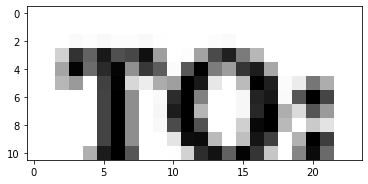

In [ ]:
import matplotlib.pyplot as plt
plt.imshow(images_list[0])

In [ ]:
text_list[0]

'TO:'

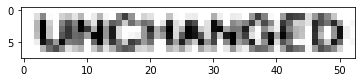

In [ ]:
plt.imshow(images_list[1234])

In [ ]:
text_list[1234]

'UNCHANGED'

Through this tutorial, we've converted a super complex dataset with lots of complex information into a much neater organization of image-text pairs. With data organized like this, perhaps you could train a machine learning model to classify text given an image of said text, or some other text-image related task. Either way, I hope this has been informative and useful as a practical example on loading a real-world messy dataset.

# 2. GitHub
---
Now, we're going to talk about GitHub! I'm sure some of you are at least vaguely familiar with what GitHub is, but if not, we're going to formally introduce it, why version control is important, and how it will be helpful for your future projects. We can't talk about GitHub, however, without first talking about **Git**.

## Git and version control

Imagine that you've been working on a program for hours, but need to add a new feature to the existing code that will in some way modify what you've already written. You don't want to mess anything up, so you copy all of your code to another folder so that you have a way to "rollback" your working program if your changes mess up what you already have. While this works, it isn't the most efficient or advisable. This is where **Git** comes in. Git is a version control system, which essentially means that it tracks changes to a set of files located within a folder called a **Git repository** (or *repo*).

In essence, Git allows programmers to manage changes made to source code over time. As a version control system, Git tracks every change made to files within a repository (down to individual lines of code) and allows us to go back in time and access previous versions of the files in the repository. Each time we push a change to any of the files in our repository, it's called a **commit**. When a commit is made, the user pushing the commit is also logged by Git, and they can further specify commit messages for posterity.

## Okay, how does this related to GitHub?

Now that we're briefly established what Git is, it's time to move onto GitHub. **GitHub** is essentially a cloud-based website that allows us to host Git repositories. This allows us to access source code without being confined to a local machine, easily collaborate with other users to push commits to Git repositories, and share projects with the world. We can also *clone* repos onto our local machines and push commits by making changes to the files in the folder. 

When working on future DSU or personal projects, GitHub is an invaluable resource. It's arguably the best way to share code and keep track of the progress of everyone involved. There's two main ways to work with GitHub repostories from your computer:

1. **Command line:** Essentially, we use either Terminal on Mac or GitHub on Windows to type Git commands that allow us to work with our repositories.
2. **GitHub Desktop:** Simplifies workflow by providing a GUI which allows us to work with repositories.

For this lesson, we're going to be using the command line approach (in particular, Terminal on Mac) to walk you through creating a repository, pushing changes, and taking advantage of all the benefits of version control. 

Without further ado, let's begin!

## Creating a GitHub account

Creating an account on GitHub is super easy and completely free. Before you attempt to follow any of these steps yourself, it's important that you have an account! [Here](https://github.com/signup?ref_cta=Sign+up&ref_loc=header+logged+out&ref_page=%2F&source=header-home) is a link to create an account if you don't yet have one.

## Creating a repository

Now that you're set up with GitHub, it's time to create your first repository. If you click on the dropdown menu in the top right corner of the screen and navigate to `Your repositories`, you should see a screen similar to this.

Note that I already have a few repositories, but the steps at this point should be the same if you're new to GitHub. To create a new repo, we will simply click the green `New` button visible on screen.

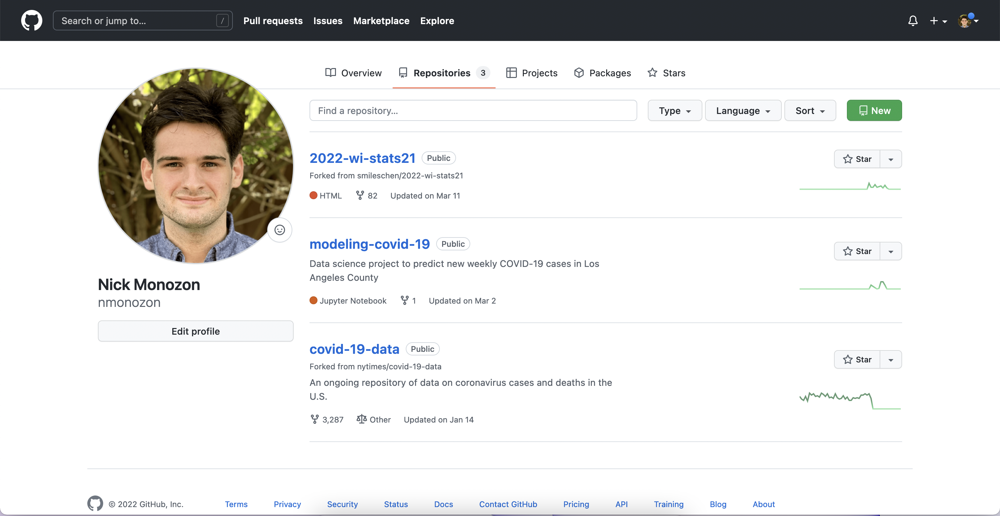

You should now see the screen below. We have options to specify the repository name, provide a brief description about the repository, choose whether it's private or public, and specify if the repo should be created with a README file.

If you choose to create a public repository, this just means that anyone will be able to access the repo files and view the commit history, but they *will not* be able to commit unless you provide them access. A private repository will be hidden on your GitHub profile. Note that this, along with the name and description, can be changed later.

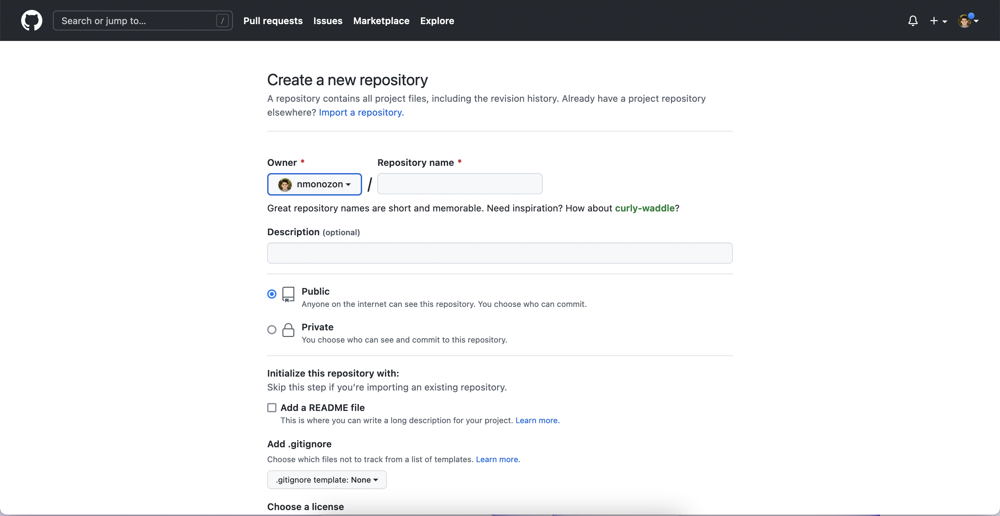

I'm going to create the public repo `dsu-spr-22` with a README file. A repo name should be descriptive, but don't make it too long, as you may be typing this a lot. After filling in this information, we can click the green `Create repository` button at the bottom of the page.

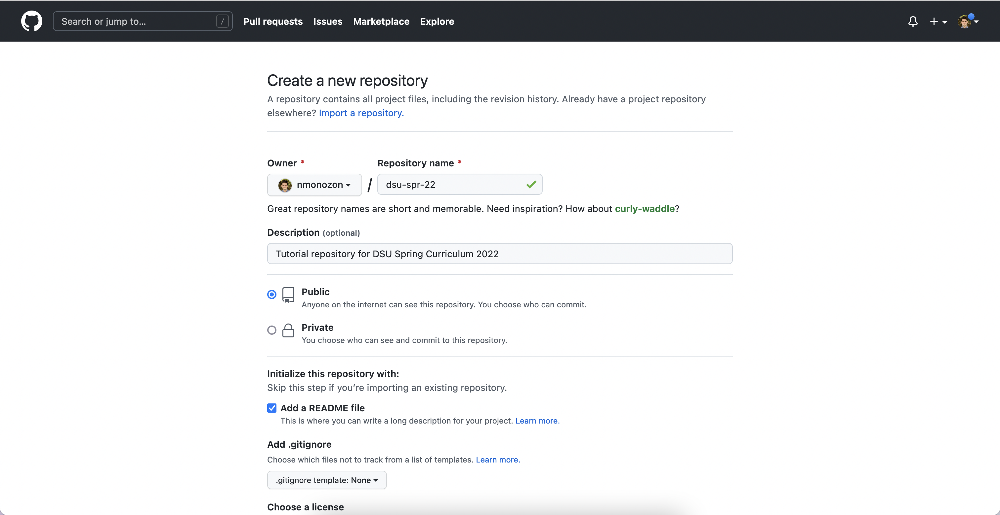

Awesome! We can now see that we have succesfully created the repo `dsu-spr-22` (which is accessible [here](https://github.com/nmonozon/dsu-spr-22)). As we can see, it currently contains one file, which is `README.md`.

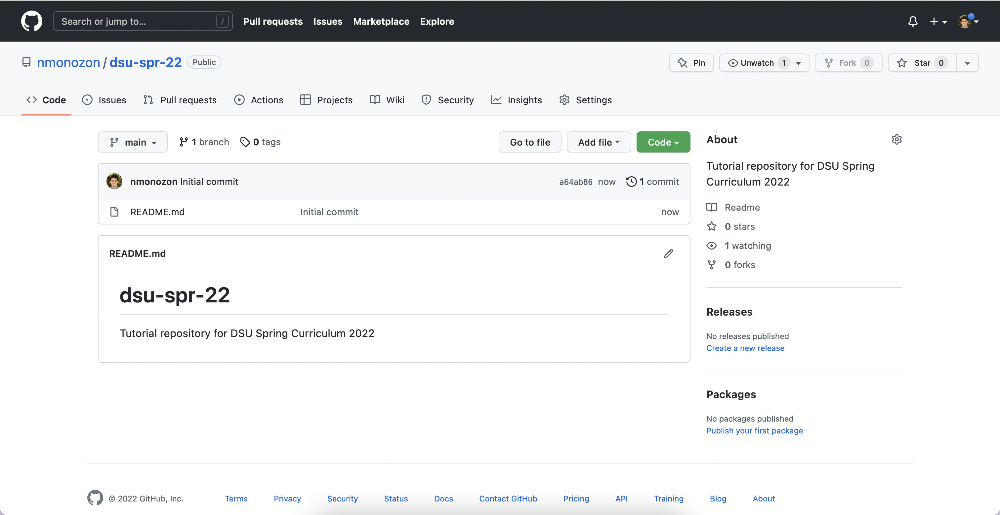

## Creating an SSH key

This is great, but we want to have a way to access the repo contents from the directory of our own computer so that we can push changes and access all of the repo files. To do this, you need a generate an **SSH key** on your computer. Since I'm on a Mac, I'll be doing this using Terminal. Using the email that you used to create your GitHub account, type the following command into your command line:

`ssh-keygen -t ed25519 -C "your_email@example.com"`

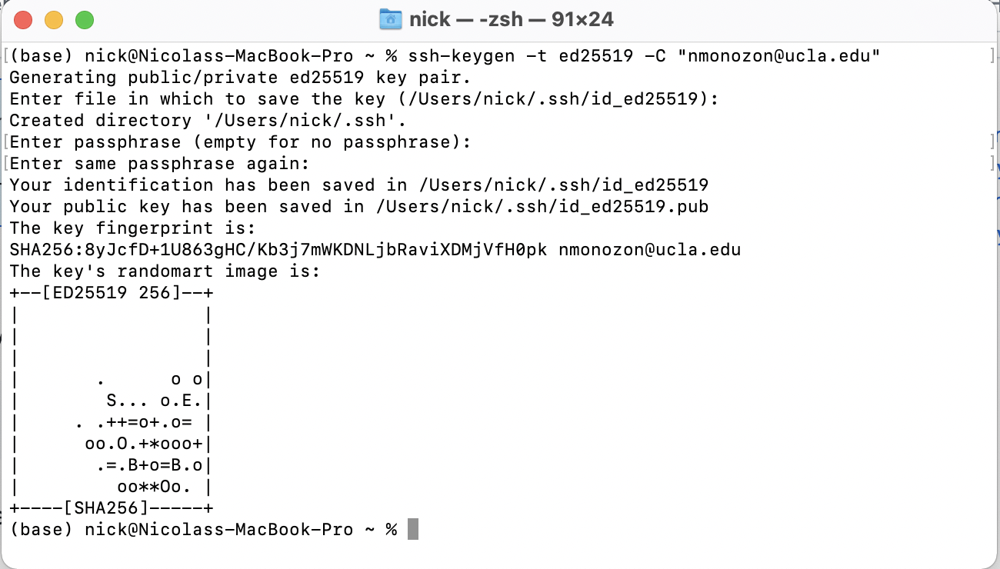

This generates a file `id_ed25519.pub` which contains the public key. If we navigate to the folder and the location listed above, we can open this file with a text editor to access the private key. You can now add this to your GitHub account by navigating to `Settings -> SSH and GPG keys`. 

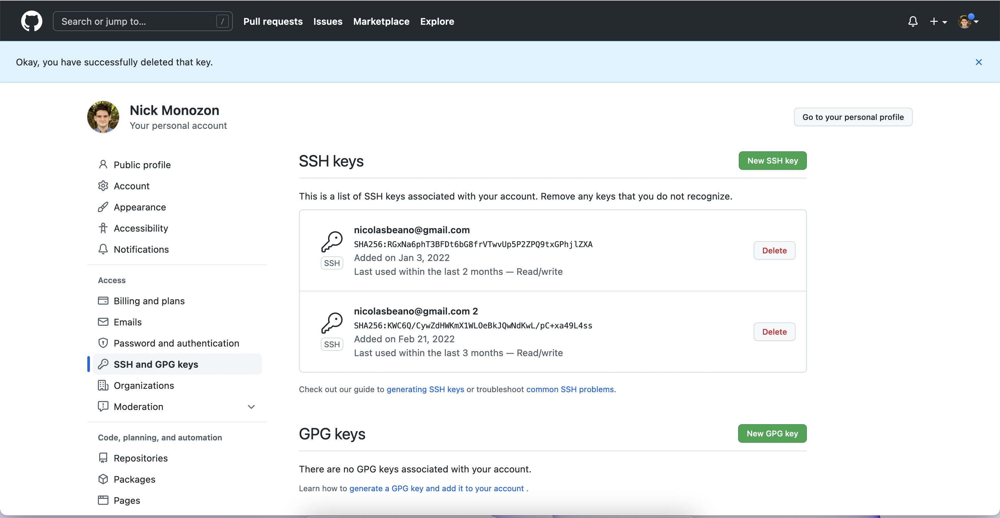

We can click on the green `New SSH key` button to add the public key found in `ed_25519.pub`. I recommending titling the key with the name of your current computer. We can copy and paste the key and click `Add SSH key`.

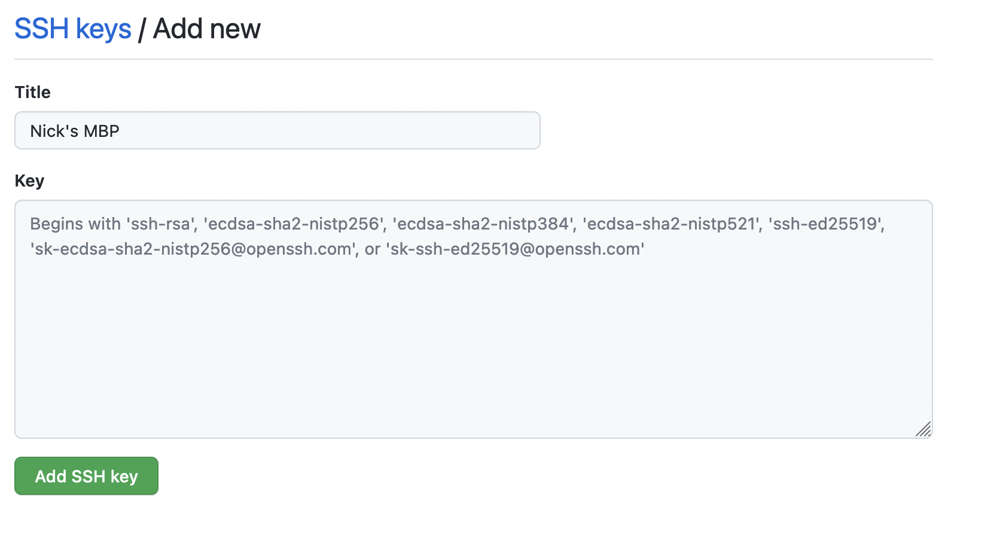

As we can now see, the SSH key has been added to my account.

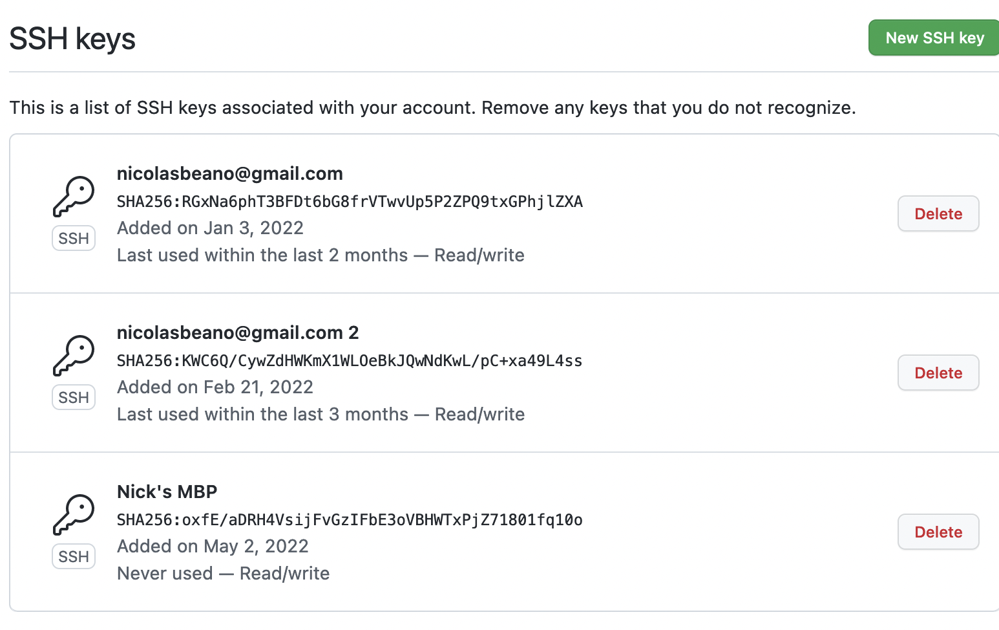

## Cloning the repo to your computer

Now that we've created the GitHub repository and added the computer's SSH key to the GitHub account, it's time to clone the repo to my computer. We are going to use our command line to do this. On the `dsu-spr-22` repo page, click the green `Code` dropdown and copy the address from the SSH tab.

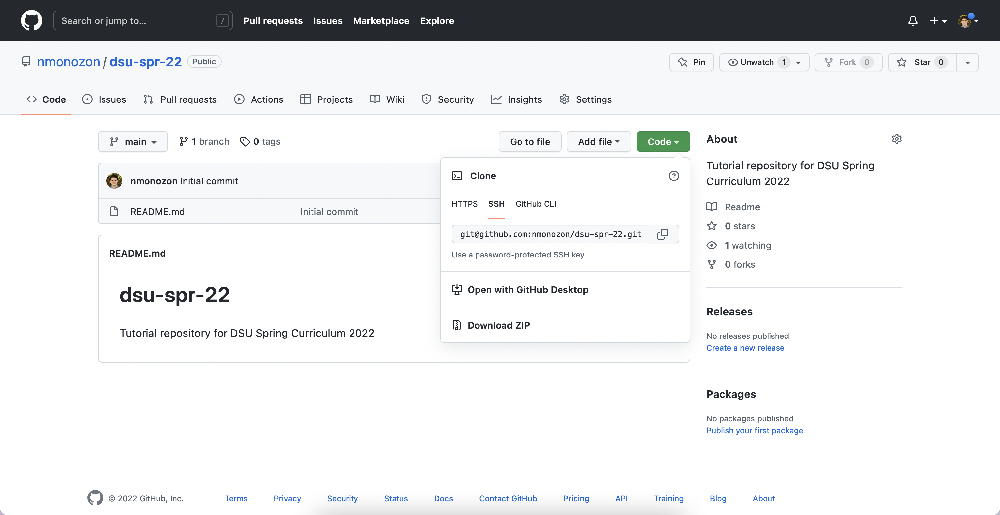

To clone `dsu-spr-22` locally, we open Terminal and type the following command:

`git clone git@github.com:nmonozon/dsu-spr-22.git`

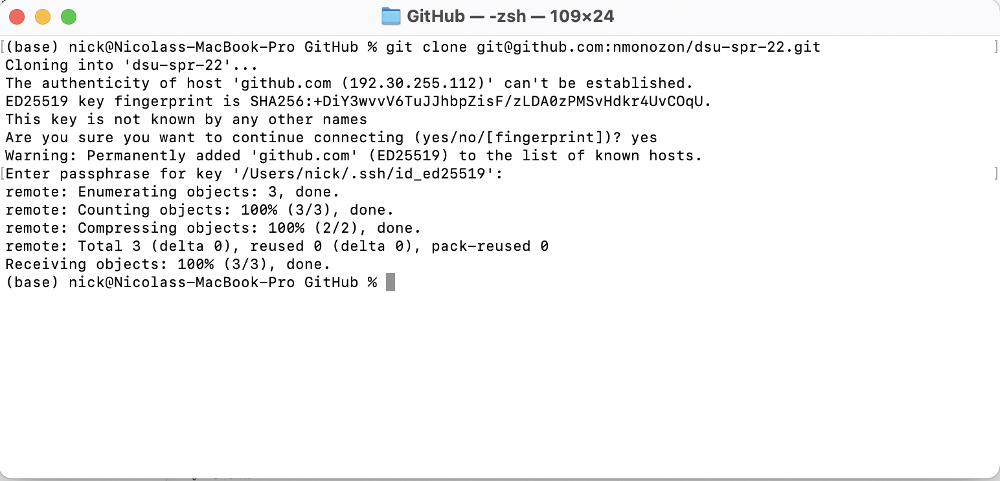

The repo `dsu-spr-22` is now cloned onto my local machine!

Note: To clone any repo in a particular directory, simply open Terminal or Git Bash within that directory and the repo will be automatically created there.

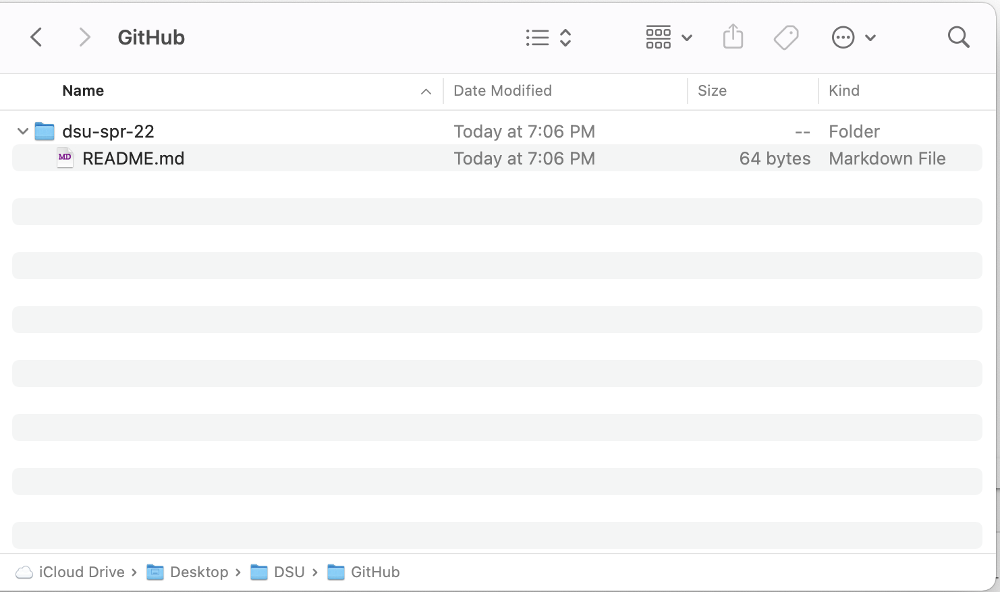

We can now add and modify files in the repo and push these changes. Let's go over how to commit a new file.

## Committing

Suppose that we want to add an image file `jesse.jpg` to the repo. We can simply drag and drop the file into the repository, but this doesn't actually update the files in the repo. We need to push this change.

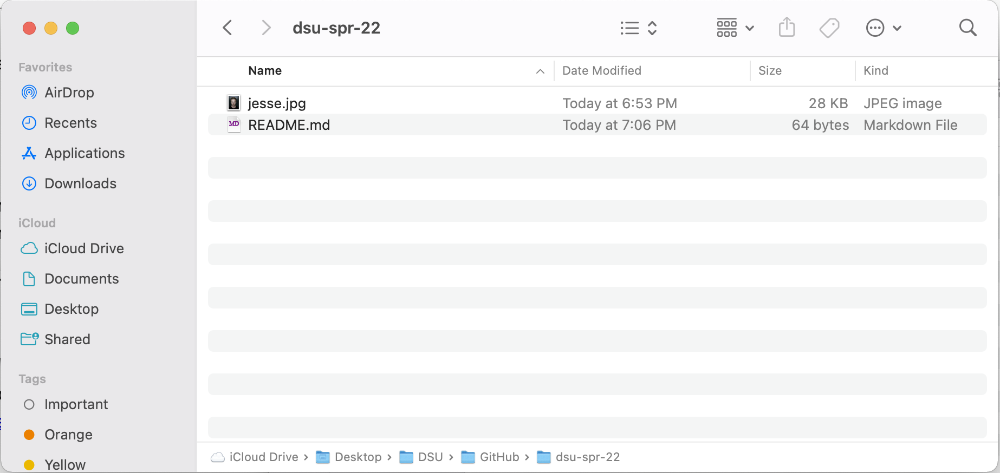

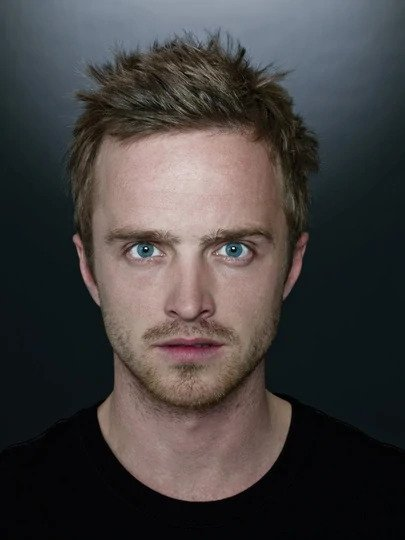

This is `jesse.jpg`.

At this point, our local repository is *out of date* with our remote repository (i.e., the repository in the cloud). To determine what changes have been made to the local repo that haven't been pushed to the remote repo, we use the command `git status`.

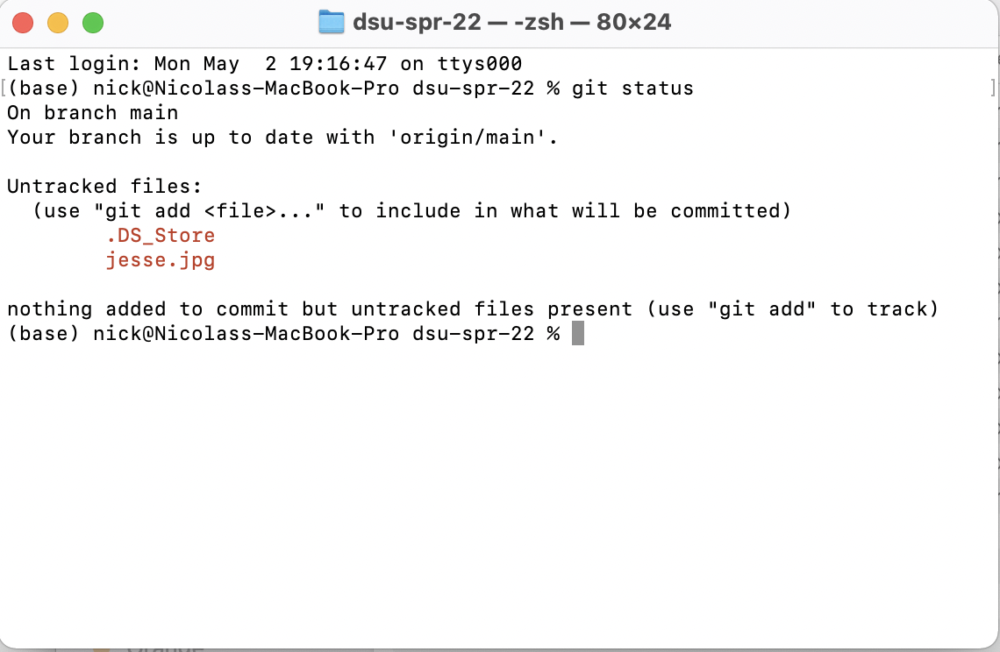

As we can see, `jesse.jpg` is an untracked file, meaning that it's in our local repo but not in the remote repo. The next step is to stage this file for commit. We run the command `git add jesse.jpg`. To commit this file, we then do the command

`git commit -m "Jesse Pinkman"`

where `"Jesse Pinkman"` is a *commit message*. Finally, we can run `git push` to push this change to our remote repository.

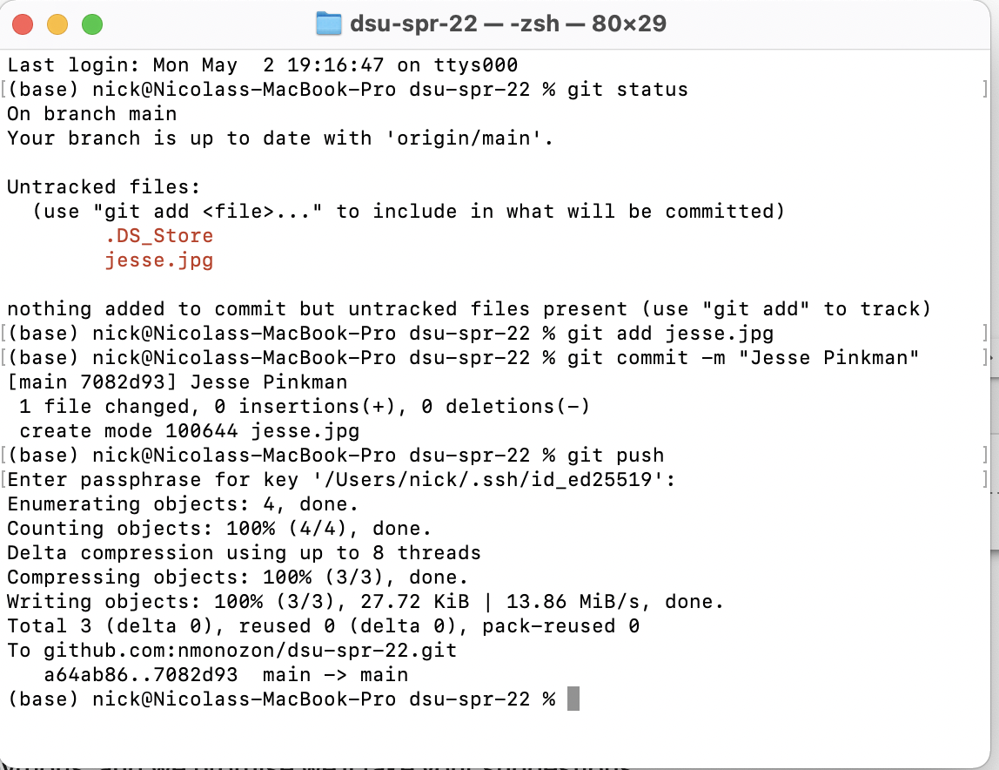

At this point, we can view the remote repo on the GitHub website to see that `jesse.jpg` is now included in the remote repo!

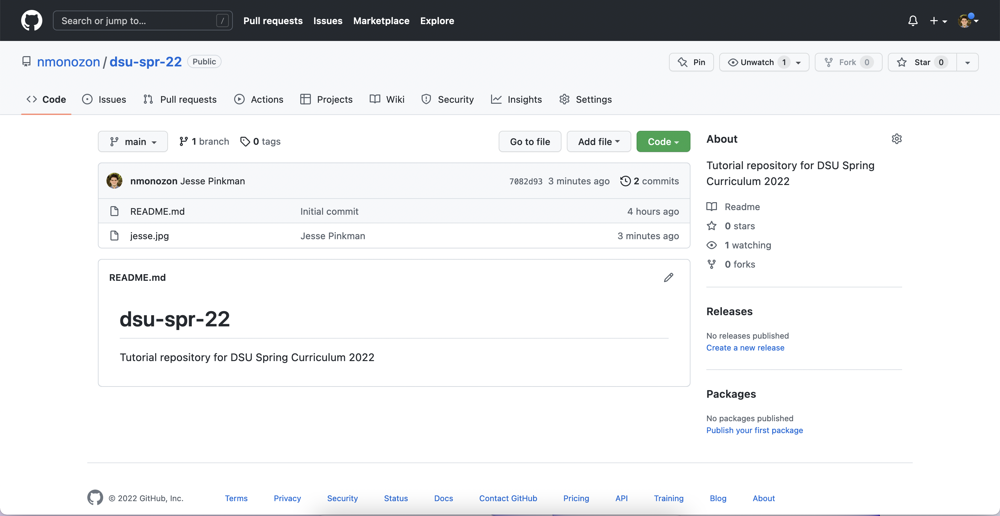

What if instead of adding a new file to the repo, we want to modify an existing file? Recall that version control tracks all of the changes, so if we edit `README.md`, Git knows that this file has been modified when we run `git status`. We can push this change in the same manner as the above.

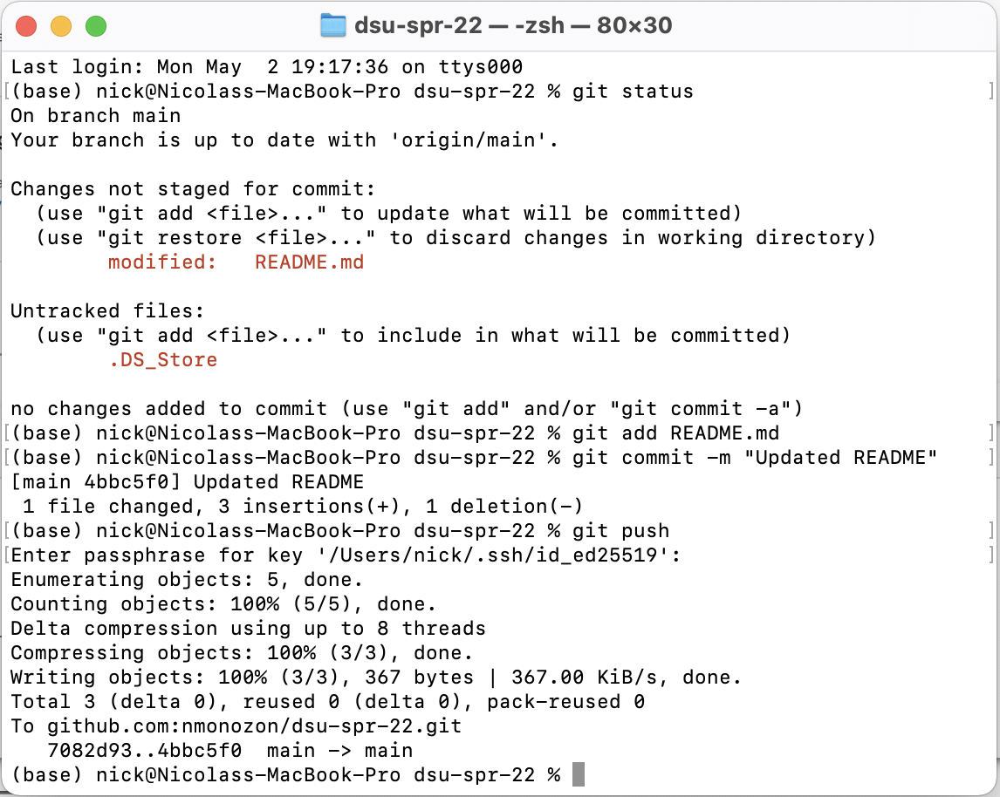

At this point, we can view the remote repository to verify that we've pushed this change. We can also look at the commit history, which gives a detailed overview of who made a new commit, when they did it, and exactly what files and lines were modified.

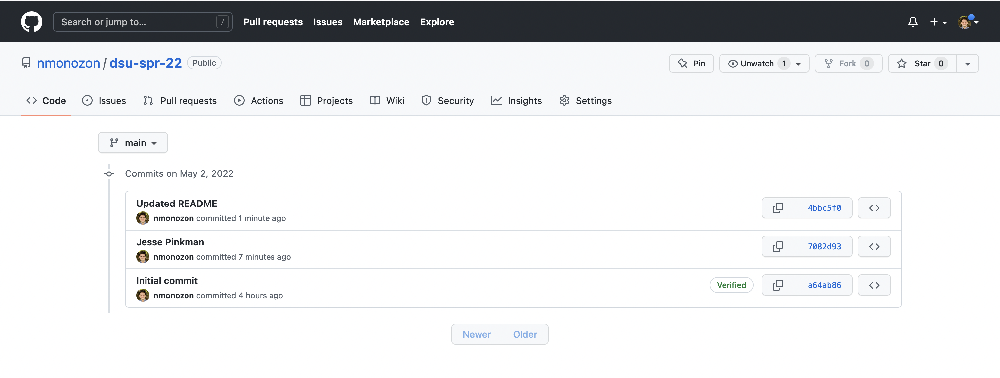

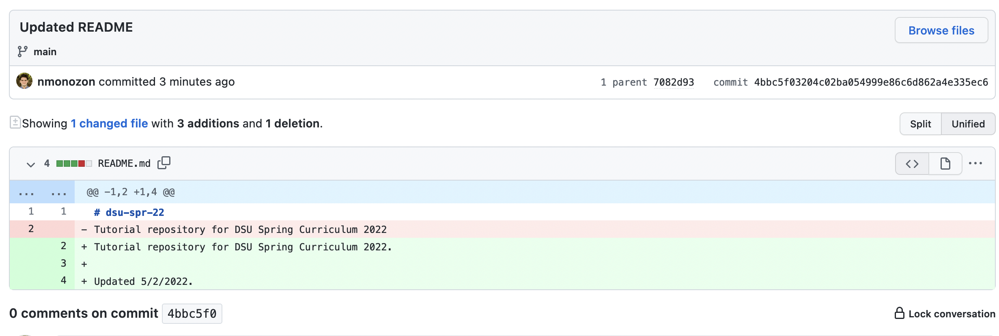

# Undoing commits

Now that we've introduced how to make new commits to our remote repository, let's talk about how to undo commits. Suppose that in error, I have another image titled `jesse.jpg` that I accidentally commit to the repo, overriding the previous image. We can view this commit in our commit history.

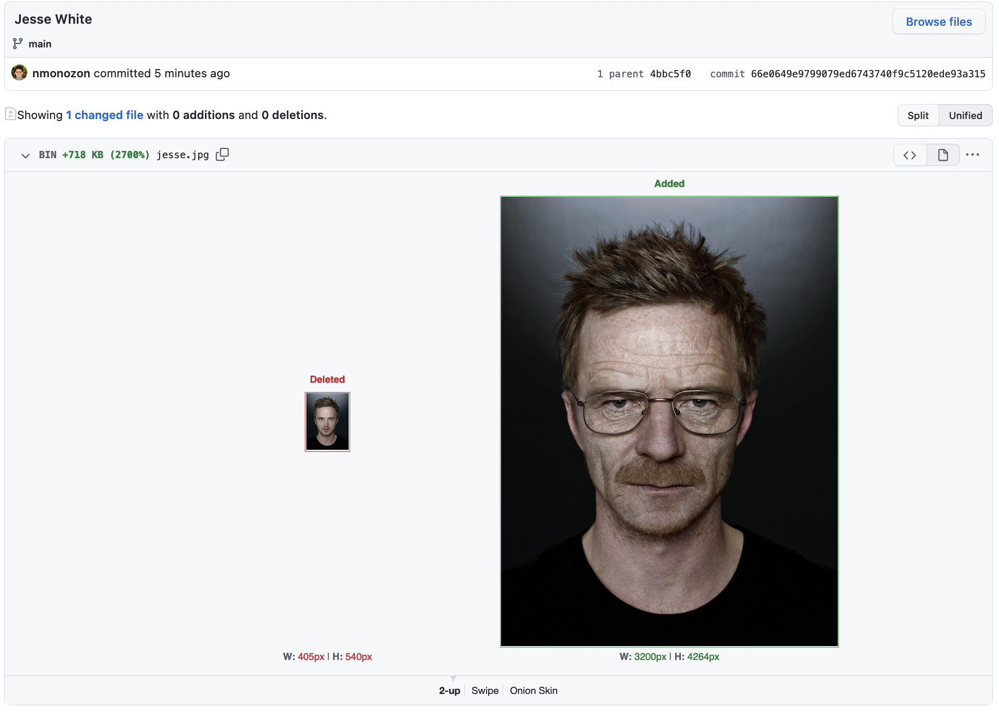

To undo this push, we're going to run two commands:

`git reset --hard HEAD^`

`git push origin -f`

If we view the repo now, we can see that this commit has been removed. Awesome, we're saved!

Note: If we wanted to undo the last two commits to the repo, we would run `git reset --hard HEAD~2`.

## Fetching changes to a remote repository

If changes are made to the remote repo, they won't automatically be made to your local repo. Sometimes, when we're collaborating with others (who can also commit to the remote repo) or have committed from a different computer, we have to fetch changes to the remote repo. To do this, we simply run `git fetch`.

In our case, no changes have been made to the remote repo that haven't been made to the local repo, so no changes are fetched.

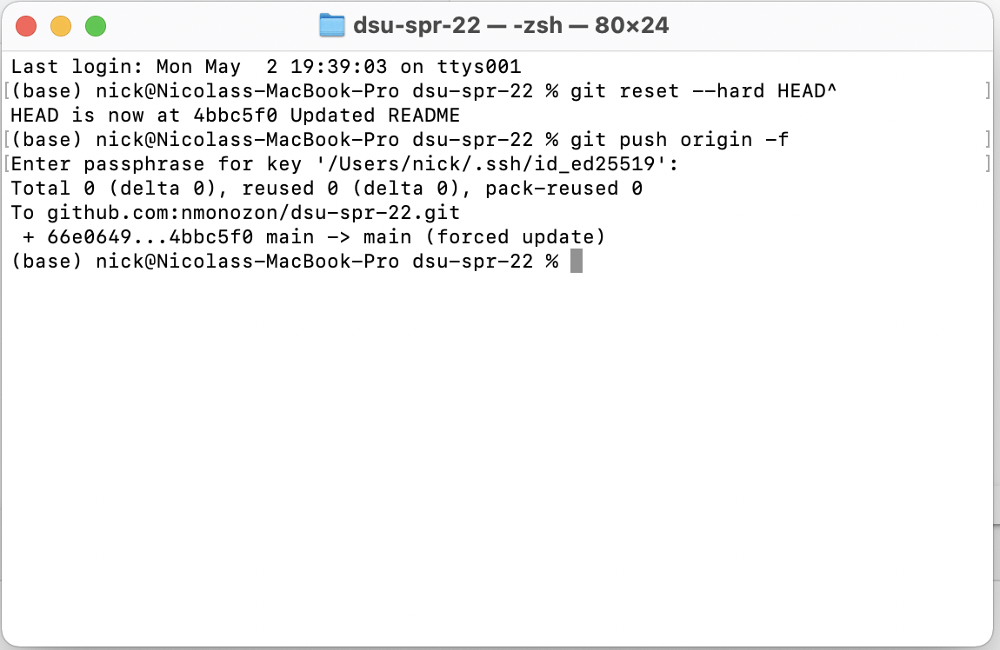

Like all things taught in curriculum, there's a lot more to Git and GitHub. These are the basics and will hopefully get you up to speed on why version control is important, how to go about creating your own repository, and how to leverage GitHub as a powerful tool for future projects.

---
# Anonymous feedback

If you have any feedback for us, please let us know! The feedback form is completely anonymous, and we promise we'll take your suggestions into consideration for future meetings: https://forms.gle/eve5noVB9ccXbomM7

#Credits

Primary Contributors:
* Daniel Mendelevitch
* Nick Monozon



Secondary Contributors:
*   Sean Tjoa
*   Tristan Dewing
*   Andy Chen
*   Emily Gong
*   Tara Jaigopal

